In [1]:
import gymnasium as gym
import aero_gym
import math
import numpy as np
from gymnasium.utils.env_checker import check_env
from gymnasium.wrappers import FrameStack, FlattenObservation
from pathlib import Path
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.transforms import Affine2D
import importlib.resources
import time
from matplotlib import animation
import os
import importlib

In [2]:
import sys
sys.path.append('../aero_gym_SB3/')
import trajectory_generators

In [3]:
plt.rcParams["animation.html"] = "jshtml"

In [4]:
tmp_dir = '/u/home/b/beckers/project-sofia/tmp_dir/'

In [17]:
# Evaluate function for continuous actions only
def evaluate(env, filename, alpha_ddot_prescribed=None):
    render_list = []
    writefile = open(filename, "w")
    obs, info = env.reset()
    done = False
    episode_return = 0
    i = 0
    while 1:
        render_list.append(env.render())
        if alpha_ddot_prescribed is None:
            action = [0.0]
        else:
            action = [alpha_ddot_prescribed[i]]
        
        writestr = ("{:5d}" + "{:11.5f}" + "{:11.3e} " * 4).format(
            info["time_step"], 
            info["t"], 
            info["scaled h_dot"], 
            info["scaled alpha"], 
            info["scaled alpha_dot"], 
            info["scaled h_ddot"])
        obs, reward, terminated, truncated, info = env.step(action)
        episode_return += reward
        writestr += ("{:11.3e} " * 4).format(info["previous scaled alpha_ddot"], info["previous scaled fy"], reward, episode_return)
        writefile.write(writestr + "\n")
        i+=1
        if terminated or truncated:
            break
    writefile.close()
    return obs, info, render_list

In [6]:
def plotfile(filename, axarr=None, label='', a=0):
    if axarr is None:
        fig, axarr = plt.subplots(ncols=3, nrows=3, figsize=(17,12))
    else:
        fig = axarr[0,0].figure
    axarr[0,0].set_ylabel('total lift')
    axarr[0,0].set_xlabel('time')
    axarr[0,1].set_ylabel('h dot')
    axarr[0,1].set_xlabel('time')
    axarr[0,2].set_ylabel('h ddot / h_ddot_scale')
    axarr[0,2].set_xlabel('time')
    axarr[1,0].set_ylabel('alpha')
    axarr[1,0].set_xlabel('time')
    axarr[1,1].set_ylabel('alpha dot')
    axarr[1,1].set_xlabel('time')
    axarr[1,2].set_ylabel('alpha ddot / alpha_ddot_scale')
    axarr[1,2].set_xlabel('time')
    axarr[2,0].set_ylabel('reward')
    axarr[2,0].set_xlabel('time step')
    axarr[2,1].set_ylabel('return (sum of rewards)')
    axarr[2,1].set_xlabel('time step')
    axarr[2,2].set_ylabel('time')
    axarr[2,2].set_xlabel('time step')

    with open(filename, "r") as readFile:
        textstr = readFile.readlines()
        all_lines = [line.split() for line in textstr]
        timestep_hist = [float(x[0]) for x in all_lines]
        t_hist = [float(x[1]) for x in all_lines]
        h_dot_list = [float(x[2]) for x in all_lines]
        alpha_list = [float(x[3]) for x in all_lines]
        alpha_dot_list = [float(x[4]) for x in all_lines]
        h_ddot_list = [float(x[5]) for x in all_lines]
        alpha_ddot_list = [float(x[6]) for x in all_lines]
        fy_hist = [float(x[7]) for x in all_lines]
        am_list = [math.pi / 4 * (-h_ddot_list[i] - a * alpha_ddot_list[i] + alpha_dot_list[i]) for i in range(len(h_ddot_list))]
        reward_list = [float(x[8]) for x in all_lines]
        episode_return_list = [float(x[9]) for x in all_lines]
        readFile.close()
            
    axarr[0,0].plot(t_hist,fy_hist,label=label, marker='o', markersize=2, linewidth=1)
    axarr[0,1].plot(t_hist,h_dot_list, marker='o', markersize=2, linewidth=1, label=(label + " (a = " + str(a)))
    axarr[0,2].plot(t_hist,h_ddot_list, marker='o', markersize=2, linewidth=1)
    axarr[1,0].plot(t_hist,alpha_list, marker='o', markersize=2, linewidth=1)
    axarr[1,1].plot(t_hist,alpha_dot_list, marker='o', markersize=2, linewidth=1)
    axarr[1,2].plot(t_hist,alpha_ddot_list, marker='o', markersize=2, linewidth=1)
    axarr[2,0].plot(timestep_hist,reward_list, marker='o', markersize=2, linewidth=1)
    axarr[2,1].plot(timestep_hist,episode_return_list, marker='o', markersize=2, linewidth=1)
    axarr[2,2].plot(timestep_hist[:-1],np.diff(t_hist), marker='o', markersize=2, linewidth=1)

    axarr[0,0].legend()
    for ax in axarr.flatten():
        ax.minorticks_on()
        ax.grid(which='both',axis='y')
    return fig, axarr

In [7]:
def animaterender(filename, render_list, pivot_idx, label='', animate_every=10):
    with open(filename, "r") as readFile:
        textstr = readFile.readlines()
        all_lines = [line.split() for line in textstr]
        t_hist = [float(x[1]) for x in all_lines]
        h_dot_list = [float(x[2]) for x in all_lines]
        alpha_list = [float(x[3]) for x in all_lines]
        alpha_dot_list = [float(x[4]) for x in all_lines]
        h_ddot_list = [float(x[5]) for x in all_lines]
        alpha_ddot_list = [float(x[6]) for x in all_lines]
        fy_hist = [float(x[7]) for x in all_lines]
        readFile.close()
        
    fig, ax = plt.subplots();
    im = ax.imshow(render_list[0][:,:,0]);

    def animate(i):
        im.set_array(render_list[i][:,:,0])
        im.set_transform(Affine2D().rotate_deg_around(*pivot_idx, alpha_list[i] * 180 / np.pi) + plt.gca().transData)

    # anim = matplotlib.animation.FuncAnimation(fig, animate, frames=len(render_list))
    # anim.save(tmp_dir + 'testlog_impulse.gif', fps=20)
    anim = matplotlib.animation.FuncAnimation(fig, animate, frames=range(0, len(render_list), animate_every))

    return anim

In [8]:
t_max = 10
delta_t = 0.1
t = np.linspace(0, t_max, int(t_max/delta_t)+1)

## No h_ddot

In [9]:
env = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=t_max,
    delta_t=delta_t,
    Re=200,
    gridRe=4,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_pressure=True,
    pressure_sensor_positions=[-0.3,-0.2,-0.1,0.0,0.1,0.2,0.3],
    h_ddot_scale=1,
    alpha_ddot_scale=1,
    vorticity_scale=10.0
)

`lift_upper_limit` and/or `lift_lower_limit` not provided, setting limits to plus and minus `lift_scale`


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12
nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [10]:
env.jl.eval("g")

<PyCall.jlwrap PhysicalGrid{2}((140, 52), (39, 26), 0.02, ((-0.76, 2.0), (-0.5, 0.5)), 12)>

In [11]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_no_hddot.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
27  0      0 59195288 535656 125020248    0    0     0    36    0    1 13 12 74  0  0
No h_ddot provided, using zeros instead
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
24  0      0 59197284 535656 125020240    0    0     0    36    0    1 13 12 74  0  0
nt_opt = 12
45.5435 seconds


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


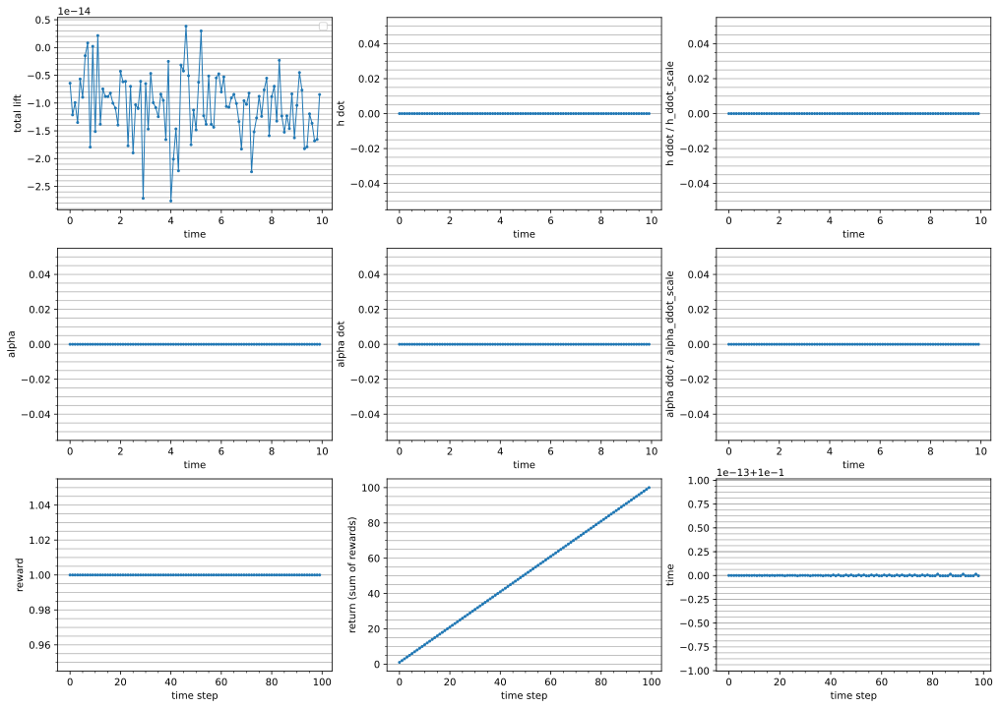

In [12]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_no_hddot.txt')

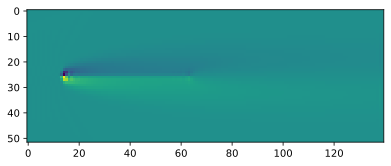

In [13]:
pivot_idx = env.jl.eval("g.I0")
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_no_hddot.txt', render_list, pivot_idx);
anim

## Impulse

In [13]:
env.reset(options={"h_ddot_prescribed":None,"h_ddot_generator":trajectory_generators.impulse(1.0)});

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
26  0      0 58800540 535656 125021096    0    0     0    36    0    1 13 12 74  0  0
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
25  0      0 58802088 535656 125021096    0    0     0    36    0    1 13 12 74  0  0
nt_opt = 12


In [14]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_impulse.txt')

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
26  0      0 58792900 535656 125021088    0    0     0    36    0    1 13 12 74  0  0
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
26  0      0 58789492 535656 125021088    0    0     0    36    0    1 13 12 74  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


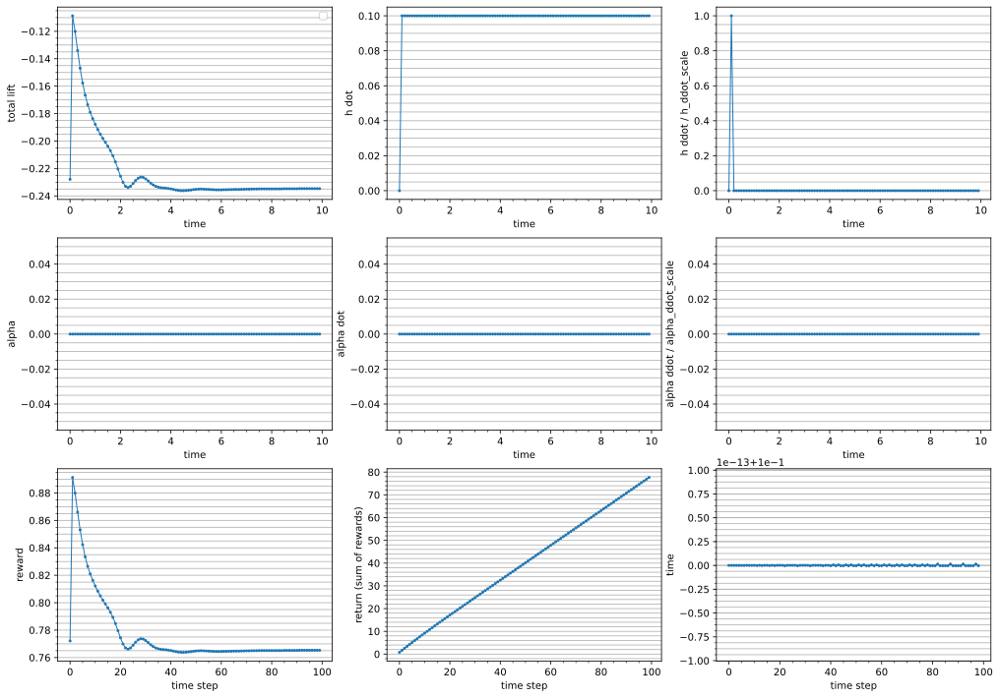

In [15]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_impulse.txt')

In [17]:
pivot_idx = env.jl.eval("g.I0")

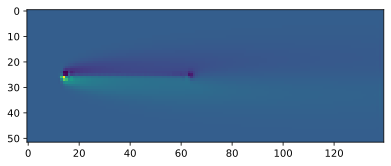

In [18]:
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_impulse.txt', render_list, pivot_idx, animate_every=1);
anim

## Step

In [19]:
env.reset(options={"h_ddot_prescribed":None,"h_ddot_generator":trajectory_generators.constant(0.1)});

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
No reference lift provided, using zeros instead
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 2  0      0 59695140 533460 124236784    0    0     0    36    0    1 13 13 74  0  0
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 2  0      0 59694620 533460 124236784    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


In [20]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_ones.txt')

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 3  0      0 59694088 533460 124236784    0    0     0    36    0    1 13 13 74  0  0
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 59694548 533460 124236784    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


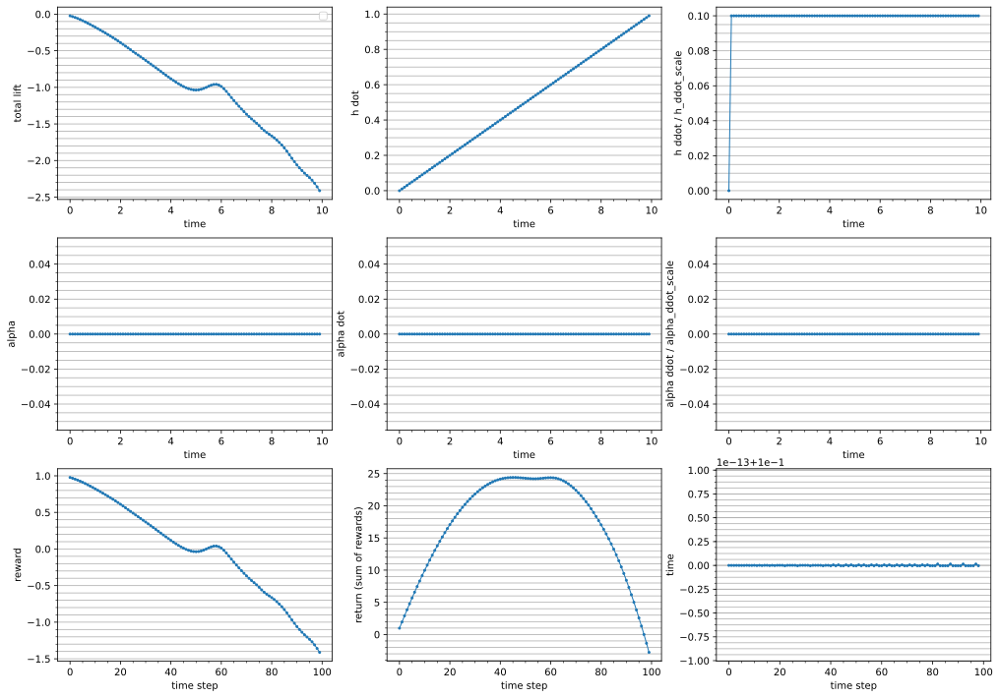

In [21]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_ones.txt')

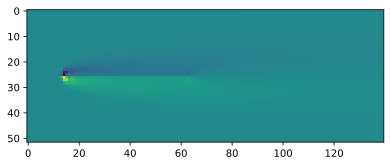

In [22]:
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_ones.txt', render_list, pivot_idx, animate_every=1);
anim

## Gaussian

In [23]:
def gaussian(x, a, b, c):
    return a * math.exp(-(x - b) ** 2 / (2 * c ** 2))

def dgaussian(x, a, b, c):
    return a * -(x - b) / c ** 2 * math.exp(-(x - b) ** 2 / (2 * c ** 2))

def ddgaussian(x, a, b, c):
    return a * (x ** 2 + b ** 2 - 2 * b * x - c ** 2) / c ** 4 * math.exp(-(x - b) ** 2 / (2 * c ** 2))

In [24]:
a = -2/3
b = 3.0
c = 0.4
h_ddot_dgaussian = [0.25 * dgaussian(ti, a, b, c) for ti in t]

a = 1/6
b = 8.0
c = 0.4
alpha_ddot_dgaussian = [ddgaussian(ti, a, b, c) for ti in t]

In [25]:
env.reset(options={"h_ddot_prescribed":h_ddot_dgaussian});

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
No reference lift provided, using zeros instead
 3  0      0 59325328 533464 124236176    0    0     0    36    0    1 13 13 74  0  0
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 59324000 533464 124236176    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


In [26]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_gaussian.txt', alpha_ddot_prescribed=alpha_ddot_dgaussian)

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 59319360 533464 124236608    0    0     0    36    0    1 13 13 74  0  0
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 4  0      0 59318676 533464 124236608    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


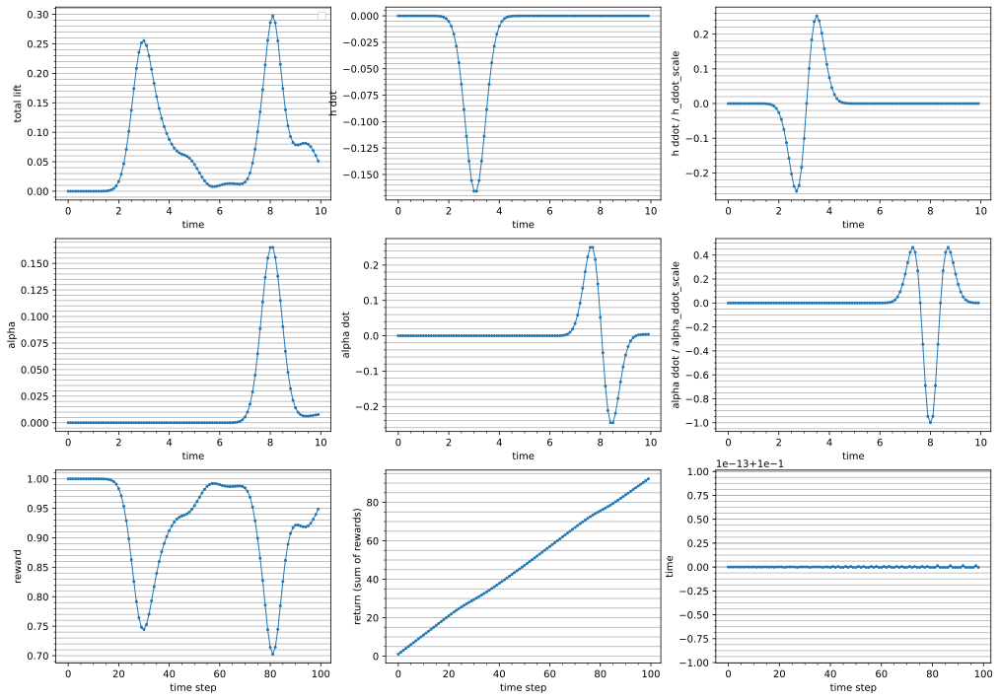

In [27]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_gaussian.txt')

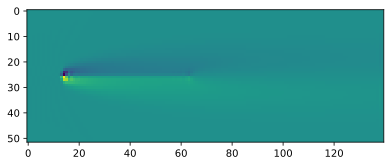

In [28]:
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_gaussian.txt', render_list, pivot_idx, animate_every=1);
anim

## Random steps/ramps

In [29]:
env_random_steps_ramps = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=t_max,
    delta_t=delta_t,
    observe_vorticity_field=False,
    observe_previous_lift=True,
    observe_previous_pressure=True,
    pressure_sensor_positions=[-0.3,-0.2,-0.1,0.0,0.1,0.2,0.3],
    h_ddot_scale=1,
    alpha_ddot_scale=0.1,
    vorticity_scale=10.0,
    lift_scale=1.0,
    h_ddot_generator=trajectory_generators.random_d_ramps(max_int_amplitude=1.0, max_d_amplitude=1.0)
)

`lift_upper_limit` and/or `lift_lower_limit` not provided, setting limits to plus and minus `lift_scale`
nt_opt = 12
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [30]:
obs, info = env_random_steps_ramps.reset()

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 58817404 533468 124236712    0    0     0    36    0    1 13 13 74  0  0
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 58818032 533468 124236712    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12

/u/home/b/beckers/unsteady_aero_RL/notebooks/../aero_gym_SB3/trajectory_generators.py:111: RuntimeWarning: divide by zero encountered in scalar divide
  increment = event_value / (end_index -  start_index)


In [31]:
obs, info, render_list = evaluate(env_random_steps_ramps, tmp_dir + 'testlog_random.txt')

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
No reference lift provided, using zeros instead
 1  0      0 58810660 533468 124236712    0    0     0    36    0    1 13 13 74  0  0
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 2  0      0 58811244 533468 124236712    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


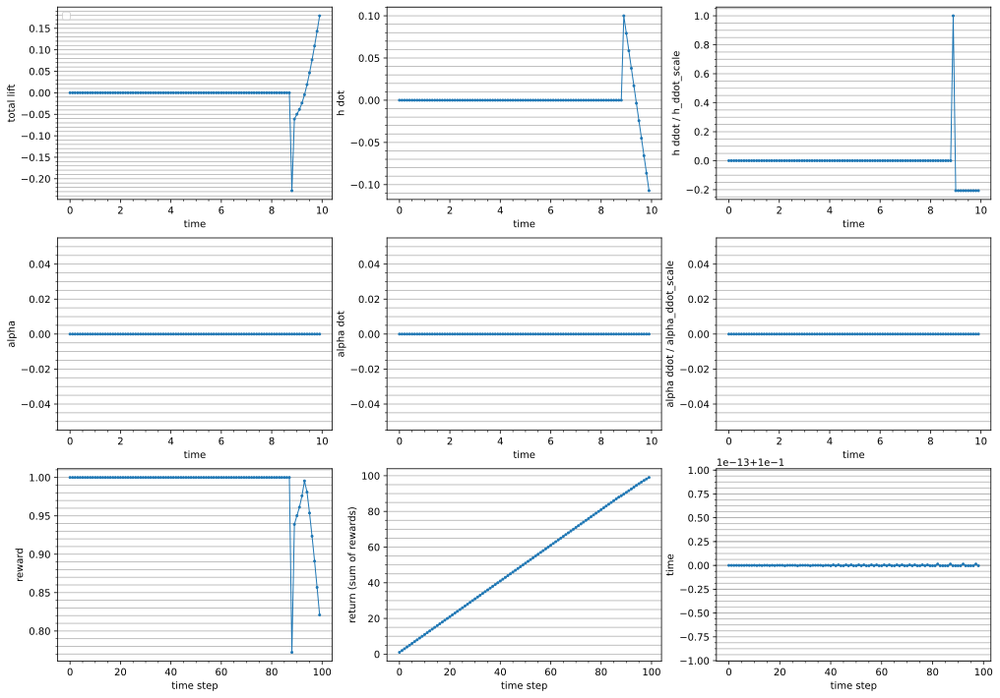

In [32]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_random.txt')

## Point forcing

In [42]:
env_forcing = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=3.0,
    delta_t=0.03,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    alpha_ddot_scale=8.0,
    lift_scale=0.1,
    lift_upper_limit=0.6,
    lift_lower_limit=-0.6,
    lift_termination=True,
    vorticity_scale=10,
    xlim=[-1,1.75],
    ylim=[-0.5,0.5],
    sys_reinit_commands_file='../aero_gym_SB3/julia_system_with_forcing.jl'
)

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12
nt_opt = 12Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.03



In [43]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env_forcing, tmp_dir + 'testlog_forcing.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
No h_ddot provided, using zeros instead
No reference lift provided, using zeros instead
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 2  0      0 57796144 533472 124234992    0    0     0    36    0    1 13 13 74  0  0
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 57793648 533472 124234328    0    0     0    36    0    1 13 13 74  0  0
nt_opt = 12amp = 1

nt_opt = 12
nt_opt = 12
nt_opt = 12
11.5384 seconds


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


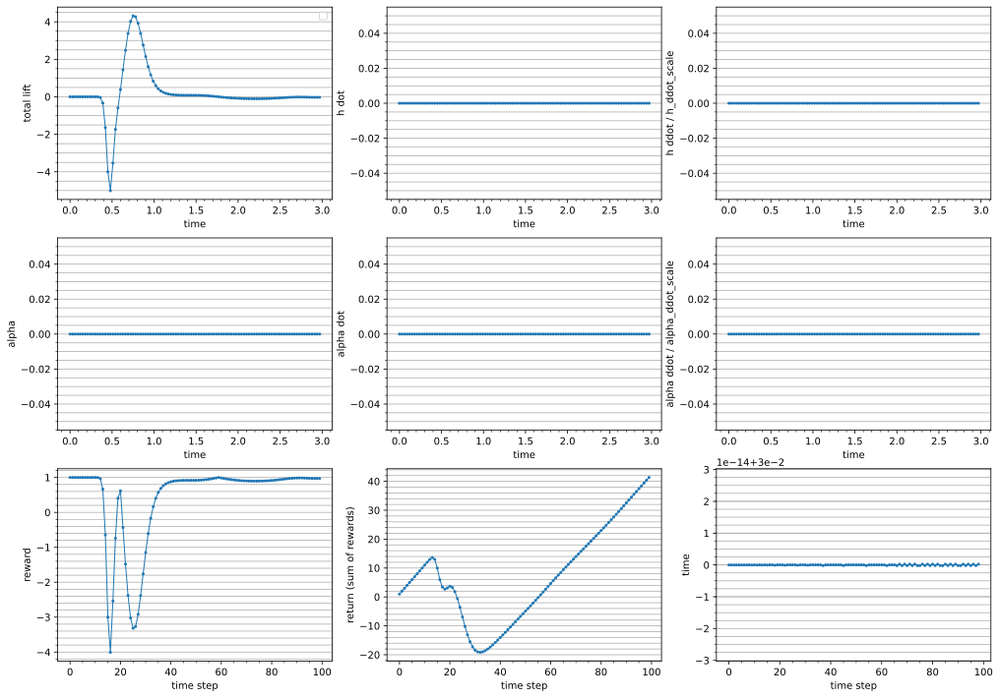

In [44]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_forcing.txt')

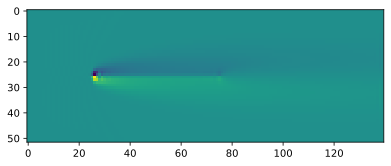

In [45]:
pivot_idx = env_forcing.jl.eval("g.I0")
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_forcing.txt', render_list, pivot_idx, animate_every=1);
anim

## alpha limit

In [ ]:
obs, info = env.reset(options={"h_ddot_generator": None, "h_ddot_prescribed": None})

In [ ]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_alpha_dot_limit.txt', alpha_ddot_prescribed=0.1*np.ones(10*len(t)))

In [ ]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_alpha_dot_limit.txt')

In [ ]:
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_alpha_dot_limit.txt', render_list, pivot_idx);
anim

## Reference lift

In [112]:
t_max_ref = 20
delta_t = 0.1
t_ref = np.linspace(0, t_max_ref, int(t_max_ref/delta_t)+1)

In [113]:
alpha_ddot_scale = 10.0
alpha = 25 * np.pi / 180
T = alpha / (alpha_ddot_scale * delta_t)
alpha_ddot_for_constant_nonzero_alpha = np.zeros(len(t_ref))
alpha_ddot_for_constant_nonzero_alpha[0] = 1
alpha_ddot_for_constant_nonzero_alpha[int(T / delta_t)] = -1

In [114]:
env_ref = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=t_max_ref,
    delta_t=delta_t,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    h_ddot_scale=0.1,
    alpha_ddot_scale=alpha_ddot_scale,
    reference_lift_generator=trajectory_generators.constant(0.5),
    lift_scale=1,
    lift_upper_limit=1.0,
    lift_lower_limit=-0.1,
    lift_termination=True,
    vorticity_scale=10,
    ylim=[-0.25,0.75]
)

nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12


In [115]:
obs, info, render_list = evaluate(env_ref, tmp_dir + 'testlog_reference_lift.txt', alpha_ddot_prescribed = alpha_ddot_for_constant_nonzero_alpha)

procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0 477256 164259136 219684 5243748    0    0     3    31    0    0  6  3 91  0  0
No h_ddot provided, using zeros instead
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


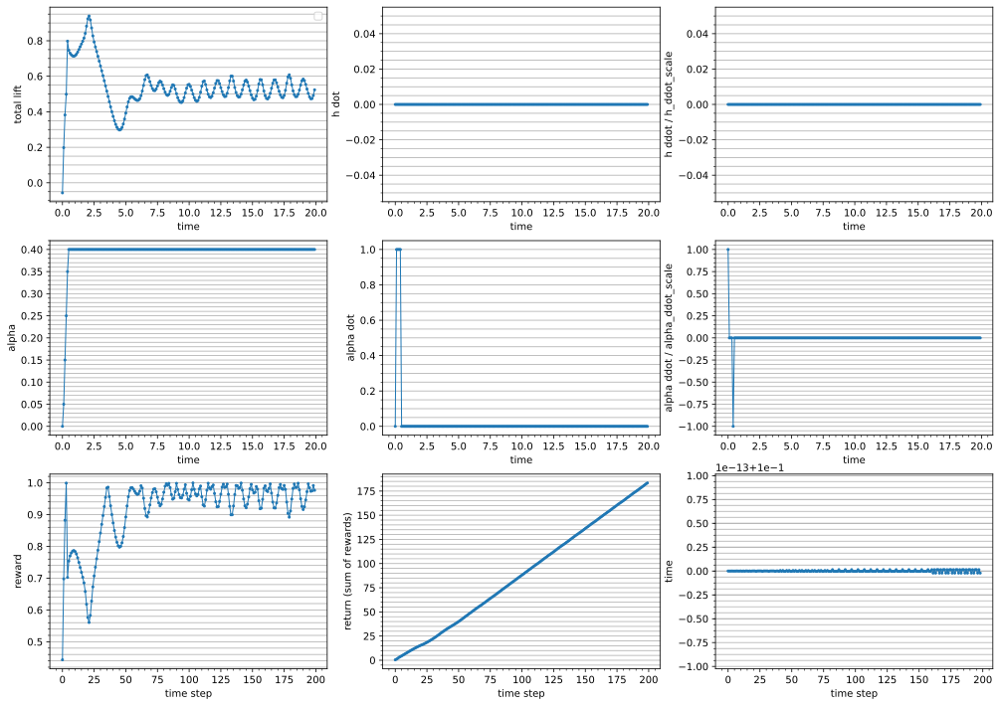

In [116]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_reference_lift.txt')

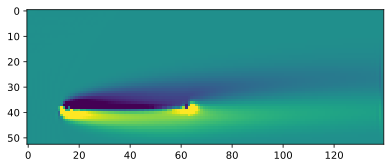

In [117]:
pivot_idx = env_ref.jl.eval("g.I0")
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender(tmp_dir + 'testlog_reference_lift.txt', render_list, pivot_idx, animate_every=1);
anim

## Vortex shedding

In [14]:
env_vks = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=10,
    delta_t=delta_t,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    h_ddot_scale=0.1,
    alpha_ddot_scale=10,
    reference_lift_generator=trajectory_generators.constant(0.7),
    lift_scale=1,
    lift_upper_limit=1.0,
    lift_lower_limit=-0.1,
    lift_termination=True,
    vorticity_scale=10,
    ylim=[-0.55,0.65],
    alpha_init=0.52356,
    initialization_time=10
)

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [15]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env_vks, tmp_dir + 'testlog_vks.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

No h_ddot provided, using zeros instead
30.5215 seconds


In [51]:
obsspace = env.observation_space.spaces["scalars"]

In [52]:
obsspace.high

array([inf, inf, inf, inf, inf, inf, inf, inf, inf, inf], dtype=float32)